In [1]:
# Initial imports
import os
import pandas as pd
from dotenv import load_dotenv
load_dotenv()
from newsapi import NewsApiClient
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')
analyzer = SentimentIntensityAnalyzer()


%matplotlib inline

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [2]:
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ACER\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [3]:
# Read your api key environment variable
api_key = "c8a1e7eaa0f6412fba00fd964c1ce000"

In [4]:
# Create a newsapi client
newsapi = NewsApiClient(api_key=api_key)

In [5]:
# Fetch the Bitcoin news articles
btc_headlines = newsapi.get_everything(q="bitcoin", language="en", page_size=100,sort_by="relevancy")
btc_articles = btc_headlines["articles"]
btc_articles[0]

{'source': {'id': None, 'name': 'Gizmodo.com'},
 'author': 'Vinamrata Chaturvedi, Quartz',
 'title': 'Everything to Know About Bitcoin Pizza Day',
 'description': 'On May 22, 2010, a man in Florida paid 10,000 Bitcoin for pizza.Read more...',
 'url': 'https://gizmodo.com/bitcoin-pizza-day-date-origin-history-cryptocurrency-1851487831',
 'urlToImage': 'https://i.kinja-img.com/image/upload/c_fill,h_675,pg_1,q_80,w_1200/98aec6479bad523f5c89763f4acf0cf9.jpg',
 'publishedAt': '2024-05-20T13:20:00Z',
 'content': 'On January 3, 2009, Bitcoins creator, Satoshi Nakamoto, mined the first block of the Bitcoin blockchain, known as the Genesis Block, which contained a reward of 50 Bitcoin. The technical foundations … [+1156 chars]'}

In [6]:
# Fetch the Ethereum news articles
eth_headlines = newsapi.get_everything(q="ethereum", language="en", page_size=100,sort_by="relevancy")
eth_articles = eth_headlines["articles"]
eth_articles[0]

{'source': {'id': 'the-verge', 'name': 'The Verge'},
 'author': 'Gaby Del Valle',
 'title': 'Two brothers accused of stealing $25 million worth of crypto',
 'description': 'The brothers, Anton and James Peraire-Bueno, face up to 60 years in prison if convicted.',
 'url': 'https://www.theverge.com/2024/5/16/24158398/crypto-ethereum-heist-peraire-bueno-brothers',
 'urlToImage': 'https://cdn.vox-cdn.com/thumbor/IoqvDVRfH_TRVzXzP28JYCE7eLw=/0x0:2040x1360/1200x628/filters:focal(1020x680:1021x681)/cdn.vox-cdn.com/uploads/chorus_asset/file/23951328/STK015_VRG_Illo_N_Barclay_7_ethereum.jpg',
 'publishedAt': '2024-05-16T20:46:45Z',
 'content': 'Two brothers accused of stealing $25 million worth of crypto\r\nTwo brothers accused of stealing $25 million worth of crypto\r\n / The heist took just 12 minutes to execute, prosecutors claim.\r\nByGaby De… [+2933 chars]'}

In [7]:
# Create the Bitcoin sentiment scores DataFrame
btc_sentiments = []

for article in btc_articles:
    try:
        text = article["content"]
        date = article["publishedAt"][:10]
        sentiment = analyzer.polarity_scores(text)
        compound = sentiment["compound"]
        pos = sentiment["pos"]
        neu = sentiment["neu"]
        neg = sentiment["neg"]
        
        btc_sentiments.append({
            "text": text,
            "date": date,
            "compound": compound,
            "positive": pos,
            "negative": neg,
            "neutral": neu
            
        })
        
    except AttributeError:
        pass
    
# Create DataFrame
btc_df = pd.DataFrame(btc_sentiments)

# Reorder DataFrame columns
cols = ["date", "text", "compound", "positive", "negative", "neutral"]
btc_df = btc_df[cols]

In [8]:
# Drop duplicates articles
btc_df.drop_duplicates(keep="first", inplace=True)
btc_df.head()

,date,text,compound,positive,negative,neutral
0,2024-05-20,"On January 3, 2009, Bitcoins creator, Satoshi ...",-0.2732,0.096,0.151,0.753
1,2024-05-01,"As a test of their resulting AI tool, the rese...",0.2755,0.066,0.000,0.934
2,2024-05-20,Weve seen a cascading effect from the pronounc...,0.0000,0.000,0.000,1.000
3,2024-05-08,Some creditors of the bankrupt crypto exchange...,-0.6801,0.067,0.193,0.740
4,2024-05-04,Jack Dorsey's financial services and digital p...,-0.4767,0.081,0.167,0.752


In [9]:
# Create the ethereum sentiment scores DataFrame
eth_sentiments = []

for article in eth_articles:
    try:
        text = article["content"]
        date = article["publishedAt"][:10]
        sentiment = analyzer.polarity_scores(text)
        compound = sentiment["compound"]
        pos = sentiment["pos"]
        neu = sentiment["neu"]
        neg = sentiment["neg"]
        
        eth_sentiments.append({
            "text": text,
            "date": date,
            "compound": compound,
            "positive": pos,
            "negative": neg,
            "neutral": neu
            
        })
        
    except AttributeError:
        pass
    
# Create DataFrame
eth_df = pd.DataFrame(eth_sentiments)

# Reorder DataFrame columns
cols = ["date", "text", "compound", "positive", "negative", "neutral"]
eth_df = eth_df[cols]

In [10]:
# Drop duplicates articles
eth_df.drop_duplicates(keep="first", inplace=True)
eth_df.head()

,date,text,compound,positive,negative,neutral
0,2024-05-16,Two brothers accused of stealing $25 million w...,-0.8402,0.087,0.271,0.642
1,2024-05-28,The London Stock Exchange (LSE) has begun trad...,0.0000,0.000,0.000,1.000
2,2024-05-28,The past week was monumental for crypto as the...,0.7717,0.189,0.000,0.811
3,2024-05-31,"Ethereum is poised for a major rally, say many...",0.2500,0.059,0.000,0.941
4,2024-05-22,As the crypto world eagerly awaits the potenti...,0.8316,0.253,0.000,0.747


In [11]:
# Describe the Bitcoin Sentiment
btc_df.describe()

,compound,positive,negative,neutral
count,100.000000,100.000000,100.000000,100.000000
mean,0.162843,0.084470,0.041650,0.873890
std,0.457132,0.077739,0.073681,0.099382
min,-0.927400,0.000000,0.000000,0.524000
25%,0.000000,0.000000,0.000000,0.801750
50%,0.084700,0.073500,0.000000,0.869500
75%,0.557400,0.131000,0.063250,0.955500
max,0.928700,0.355000,0.397000,1.000000


In [12]:
# Describe the Ethereum Sentiment
eth_df.describe()

,compound,positive,negative,neutral
count,100.000000,100.000000,100.000000,100.000000
mean,0.311160,0.110620,0.029440,0.859940
std,0.464855,0.088649,0.069805,0.101066
min,-0.927400,0.000000,0.000000,0.524000
25%,0.000000,0.042750,0.000000,0.811000
50%,0.449600,0.114000,0.000000,0.861000
75%,0.690800,0.168250,0.000000,0.930500
max,0.948500,0.447000,0.397000,1.000000


---

In [13]:
from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer, PorterStemmer
from string import punctuation
import regex
import re

In [14]:
btc_text_df = btc_df['text'].astype('string')
btc_text_df

0     On January 3, 2009, Bitcoins creator, Satoshi ...
1     As a test of their resulting AI tool, the rese...
2     Weve seen a cascading effect from the pronounc...
3     Some creditors of the bankrupt crypto exchange...
4     Jack Dorsey's financial services and digital p...
                            ...                        
95    Early Bitcoin investor Roger Ver, also known a...
96    Early crypto investor Roger Ver, a.k.a. Bitcoi...
97    My husband and I lived in Arkansas for a littl...
98    Google CEO Sundar PichaiMateusz Wlodarczyk/Nur...
99    On January 3, 2009, Bitcoins creator, Satoshi ...
Name: text, Length: 100, dtype: string

In [15]:
eth_text_df = eth_df['text'].astype('string')
eth_text_df

0     Two brothers accused of stealing $25 million w...
1     The London Stock Exchange (LSE) has begun trad...
2     The past week was monumental for crypto as the...
3     Ethereum is poised for a major rally, say many...
4     As the crypto world eagerly awaits the potenti...
                            ...                        
95    Farcaster integrated with Arbitrum amidst the ...
96    CoinspeakerEthereum Options Turn Bullish as ET...
97    Open interest for ETH futures reached $12 bill...
98    Jan Happel and Yann Allemann, the co-founders ...
99    Ethereum price has dropped below $3,000, hitti...
Name: text, Length: 100, dtype: string

In [16]:
# Complete the tokenizer function
def tokenizer(text):

    """Tokenizes text."""

    # Create a list of the words
    words = [word_tokenize(sentence) for sentence in text]

    # Remove punctuation using regex; Remove any non-string character and replace with empty space
    regex = re.compile("[^a-zA-Z ]")
    re_clean = regex.sub('', text)
    words_clean = word_tokenize(re_clean)
   
   # Remove the stop words
    sw = set(stopwords.words('english'))
    first_pass = [word for word in words_clean if word not in sw]

    # Define additional stopwords
    sw_addon = {'char', 'chars' 'la', 'im','volod', 'drin', 'wa', 'ha'}
    second_pass = [word.lower() for word in words_clean if word.lower() not in sw.union(sw_addon)] 

    # Lemmatize Words into root words; convert the words to lowercase
    lemmatizer = WordNetLemmatizer()
    lem = [lemmatizer.lemmatize(word) for word in words_clean]
    tokens = [word.lower() for word in lem if word.lower() not in sw.union(sw_addon)] 
  
    return tokens

In [17]:
# Tokenizing article in the first row of the "text" column
tokenizer(btc_text_df[0])

['january',
 'bitcoins',
 'creator',
 'satoshi',
 'nakamoto',
 'mined',
 'first',
 'block',
 'bitcoin',
 'blockchain',
 'known',
 'genesis',
 'block',
 'contained',
 'reward',
 'bitcoin',
 'technical',
 'foundation']

In [18]:
# Create for-loop to iterate through rows in the "text" column 
btc_tokens = []
for row in btc_text_df:
    token = tokenizer(row)
    btc_tokens.append(token)

    print(btc_tokens) 

[['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin', 'blockchain', 'known', 'genesis', 'block', 'contained', 'reward', 'bitcoin', 'technical', 'foundation']]
[['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin', 'blockchain', 'known', 'genesis', 'block', 'contained', 'reward', 'bitcoin', 'technical', 'foundation'], ['test', 'resulting', 'ai', 'tool', 'researcher', 'checked', 'output', 'one', 'cryptocurrency', 'exchangewhich', 'paper', 'doesnt', 'nameidentifying', 'suspicious', 'chain', 'transaction', 'ult']]
[['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin', 'blockchain', 'known', 'genesis', 'block', 'contained', 'reward', 'bitcoin', 'technical', 'foundation'], ['test', 'resulting', 'ai', 'tool', 'researcher', 'checked', 'output', 'one', 'cryptocurrency', 'exchangewhich', 'paper', 'doesnt', 'nameidentifying', 'suspicious', 'chain', 'transaction', 'ult'], 

In [19]:
# Create a new tokens column for bitcoin
btc_df['btc_token'] = btc_tokens
btc_df.head()

,date,text,compound,positive,negative,neutral,btc_token
0,2024-05-20,"On January 3, 2009, Bitcoins creator, Satoshi ...",-0.2732,0.096,0.151,0.753,"[january, bitcoins, creator, satoshi, nakamoto..."
1,2024-05-01,"As a test of their resulting AI tool, the rese...",0.2755,0.066,0.000,0.934,"[test, resulting, ai, tool, researcher, checke..."
2,2024-05-20,Weve seen a cascading effect from the pronounc...,0.0000,0.000,0.000,1.000,"[weve, seen, cascading, effect, pronouncement,..."
3,2024-05-08,Some creditors of the bankrupt crypto exchange...,-0.6801,0.067,0.193,0.740,"[creditor, bankrupt, crypto, exchange, ftx, pr..."
4,2024-05-04,Jack Dorsey's financial services and digital p...,-0.4767,0.081,0.167,0.752,"[jack, dorseys, financial, service, digital, p..."


In [20]:
eth_tokens = []
for row in eth_text_df:
    token = tokenizer(row)
    eth_tokens.append(token)

    print(eth_tokens) 

[['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused', 'stealing', 'million', 'worth', 'crypto', 'heist', 'took', 'minute', 'execute', 'prosecutor', 'claimbygaby', 'de']]
[['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused', 'stealing', 'million', 'worth', 'crypto', 'heist', 'took', 'minute', 'execute', 'prosecutor', 'claimbygaby', 'de'], ['london', 'stock', 'exchange', 'lse', 'begun', 'trading', 'bitcoin', 'btc', 'ethereum', 'eth', 'exchangetraded', 'note', 'etns', 'potentially', 'paving', 'way', 'uk', 'become', 'europes', 'crypto', 'hub', 'according', 'alex']]
[['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused', 'stealing', 'million', 'worth', 'crypto', 'heist', 'took', 'minute', 'execute', 'prosecutor', 'claimbygaby', 'de'], ['london', 'stock', 'exchange', 'lse', 'begun', 'trading', 'bitcoin', 'btc', 'ethereum', 'eth', 'exchangetraded', 'note', 'etns', 

In [21]:
# Create a new tokens column for ethereum
eth_df['eth_token'] = eth_tokens
eth_df.head()

,date,text,compound,positive,negative,neutral,eth_token
0,2024-05-16,Two brothers accused of stealing $25 million w...,-0.8402,0.087,0.271,0.642,"[two, brother, accused, stealing, million, wor..."
1,2024-05-28,The London Stock Exchange (LSE) has begun trad...,0.0000,0.000,0.000,1.000,"[london, stock, exchange, lse, begun, trading,..."
2,2024-05-28,The past week was monumental for crypto as the...,0.7717,0.189,0.000,0.811,"[past, week, monumental, crypto, sec, approved..."
3,2024-05-31,"Ethereum is poised for a major rally, say many...",0.2500,0.059,0.000,0.941,"[ethereum, poised, major, rally, say, many, cr..."
4,2024-05-22,As the crypto world eagerly awaits the potenti...,0.8316,0.253,0.000,0.747,"[crypto, world, eagerly, awaits, potential, ap..."


---

# NGrams and Frequency Analysis

In this section you will look at the ngrams and word frequency for each coin. 

1. Use NLTK to produce the n-grams for N = 2. 
2. List the top 10 words for each coin. 

In [22]:
from collections import Counter
from nltk import ngrams

In [23]:
# Create one list of tokens from list of tokens in each row
btc_processed = []
for row in btc_df['btc_token']:
    for item in row:
        btc_processed.append(item)
        print(btc_processed)

['january']
['january', 'bitcoins']
['january', 'bitcoins', 'creator']
['january', 'bitcoins', 'creator', 'satoshi']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin', 'blockchain']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin', 'blockchain', 'known']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin', 'blockchain', 'known', 'genesis']
['january', 'bitcoins', 'creator', 'satoshi', 'nakamoto', 'mined', 'first', 'block', 'bitcoin', 'blockchain', 'known', 'genesis', 'block']
['j

In [24]:
eth_processed = []
for row in eth_df['eth_token']:
    for item in row:
        eth_processed.append(item)
        print(eth_processed)

['two']
['two', 'brother']
['two', 'brother', 'accused']
['two', 'brother', 'accused', 'stealing']
['two', 'brother', 'accused', 'stealing', 'million']
['two', 'brother', 'accused', 'stealing', 'million', 'worth']
['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo']
['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother']
['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused']
['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused', 'stealing']
['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused', 'stealing', 'million']
['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused', 'stealing', 'million', 'worth']
['two', 'brother', 'accused', 'stealing', 'million', 'worth', 'cryptotwo', 'brother', 'accused', 'stealing', 'million', 'worth', 'crypto']
['two', 'brother', 'accused', '

In [25]:
# Generate the Bitcoin N-grams where N=2
btc_bigram = Counter(ngrams(btc_processed, n=2))
print(dict(btc_bigram))


{('january', 'bitcoins'): 2, ('bitcoins', 'creator'): 2, ('creator', 'satoshi'): 2, ('satoshi', 'nakamoto'): 2, ('nakamoto', 'mined'): 2, ('mined', 'first'): 2, ('first', 'block'): 2, ('block', 'bitcoin'): 2, ('bitcoin', 'blockchain'): 2, ('blockchain', 'known'): 2, ('known', 'genesis'): 2, ('genesis', 'block'): 2, ('block', 'contained'): 2, ('contained', 'reward'): 2, ('reward', 'bitcoin'): 2, ('bitcoin', 'technical'): 2, ('technical', 'foundation'): 2, ('foundation', 'test'): 1, ('test', 'resulting'): 1, ('resulting', 'ai'): 1, ('ai', 'tool'): 1, ('tool', 'researcher'): 1, ('researcher', 'checked'): 1, ('checked', 'output'): 1, ('output', 'one'): 1, ('one', 'cryptocurrency'): 1, ('cryptocurrency', 'exchangewhich'): 1, ('exchangewhich', 'paper'): 1, ('paper', 'doesnt'): 1, ('doesnt', 'nameidentifying'): 1, ('nameidentifying', 'suspicious'): 1, ('suspicious', 'chain'): 1, ('chain', 'transaction'): 1, ('transaction', 'ult'): 1, ('ult', 'weve'): 1, ('weve', 'seen'): 1, ('seen', 'cascadin

In [26]:
# Print 20 most common Bitcoin bigrams
print(dict(btc_bigram.most_common(20)))

{('bitcoin', 'btc'): 5, ('bitcoin', 'price'): 5, ('exchangetraded', 'fund'): 5, ('spot', 'bitcoin'): 4, ('click', 'accept'): 4, ('accept', 'partner'): 4, ('partner', 'including'): 4, ('including', 'part'): 4, ('part', 'iab'): 4, ('iab', 'transparency'): 4, ('transparency', 'amp'): 4, ('amp', 'consent'): 4, ('consent', 'framework'): 4, ('framework', 'also'): 4, ('also', 'store'): 4, ('store', 'andor'): 4, ('andor', 'access'): 4, ('access', 'information'): 4, ('information', 'device'): 4, ('device', 'word'): 4}


In [27]:
# Generate the Ethereum N-grams where N=2
eth_bigram = Counter(ngrams(eth_processed, n=2))
print(dict(eth_bigram))


{('two', 'brother'): 3, ('brother', 'accused'): 2, ('accused', 'stealing'): 2, ('stealing', 'million'): 3, ('million', 'worth'): 3, ('worth', 'cryptotwo'): 1, ('cryptotwo', 'brother'): 1, ('worth', 'crypto'): 1, ('crypto', 'heist'): 1, ('heist', 'took'): 1, ('took', 'minute'): 1, ('minute', 'execute'): 1, ('execute', 'prosecutor'): 1, ('prosecutor', 'claimbygaby'): 1, ('claimbygaby', 'de'): 1, ('de', 'london'): 1, ('london', 'stock'): 1, ('stock', 'exchange'): 1, ('exchange', 'lse'): 1, ('lse', 'begun'): 1, ('begun', 'trading'): 1, ('trading', 'bitcoin'): 1, ('bitcoin', 'btc'): 3, ('btc', 'ethereum'): 1, ('ethereum', 'eth'): 9, ('eth', 'exchangetraded'): 4, ('exchangetraded', 'note'): 1, ('note', 'etns'): 1, ('etns', 'potentially'): 1, ('potentially', 'paving'): 1, ('paving', 'way'): 1, ('way', 'uk'): 1, ('uk', 'become'): 1, ('become', 'europes'): 1, ('europes', 'crypto'): 1, ('crypto', 'hub'): 1, ('hub', 'according'): 1, ('according', 'alex'): 1, ('alex', 'past'): 1, ('past', 'week'):

In [28]:
# Print 20 most common Ethereum bigrams
print(dict(eth_bigram.most_common(20)))

{('meme', 'coin'): 15, ('ethereum', 'etf'): 11, ('ethereum', 'eth'): 9, ('appeared', 'first'): 8, ('first', 'coinpedia'): 8, ('coinpedia', 'fintech'): 8, ('spot', 'ethereum'): 7, ('securities', 'exchange'): 7, ('exchangetraded', 'fund'): 6, ('exchange', 'commission'): 6, ('commission', 'sec'): 6, ('ethereum', 'etfs'): 5, ('eth', 'price'): 5, ('approval', 'spot'): 5, ('us', 'securities'): 5, ('ethereum', 'blockchain'): 5, ('story', 'appeared'): 5, ('ethereum', 'price'): 5, ('eth', 'exchangetraded'): 4, ('cryptocurrency', 'market'): 4}


In [29]:
# Use the token_count function to generate the top 10 words from each coin
def token_count(tokens, N=10):
    """Returns the top N tokens from the frequency count"""
    return Counter(tokens).most_common(N)

In [30]:
# Get the top 10 words for Bitcoin
btc_top_ten = token_count(btc_processed)
btc_top_ten

[('bitcoin', 48),
 ('crypto', 22),
 ('cryptocurrency', 17),
 ('price', 16),
 ('million', 13),
 ('exchange', 12),
 ('may', 11),
 ('one', 10),
 ('btc', 10),
 ('report', 10)]

In [31]:
# Get the top 10 words for Ethereum
eth_top_ten = token_count(eth_processed)
eth_top_ten

[('ethereum', 73),
 ('price', 34),
 ('eth', 23),
 ('crypto', 21),
 ('market', 20),
 ('coin', 19),
 ('spot', 18),
 ('etf', 17),
 ('bitcoin', 16),
 ('meme', 16)]

# Word Clouds

In this section, you will generate word clouds for each coin to summarize the news for each coin

In [32]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Setting the style to 'ggplot'
plt.style.use('ggplot')

# Importing necessary libraries
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = [20.0, 10.0]

# Your remaining code for creating the word cloud goes here


Text(0.5, 1.0, 'Bitcoin Word Cloud')

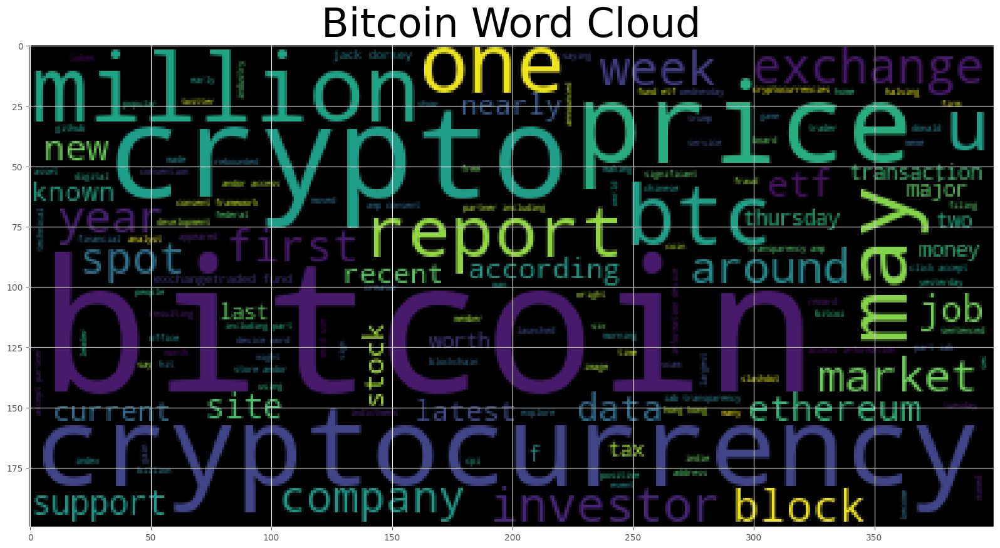

In [33]:
# Generate the Bitcoin word cloud
wc = WordCloud().generate(' '.join(btc_processed))
plt.imshow(wc)

# Add title to a Bitcoin Word Cloud 
plt.title("Bitcoin Word Cloud", fontdict={"fontsize":46})

Text(0.5, 1.0, 'Ethereum Word Cloud')

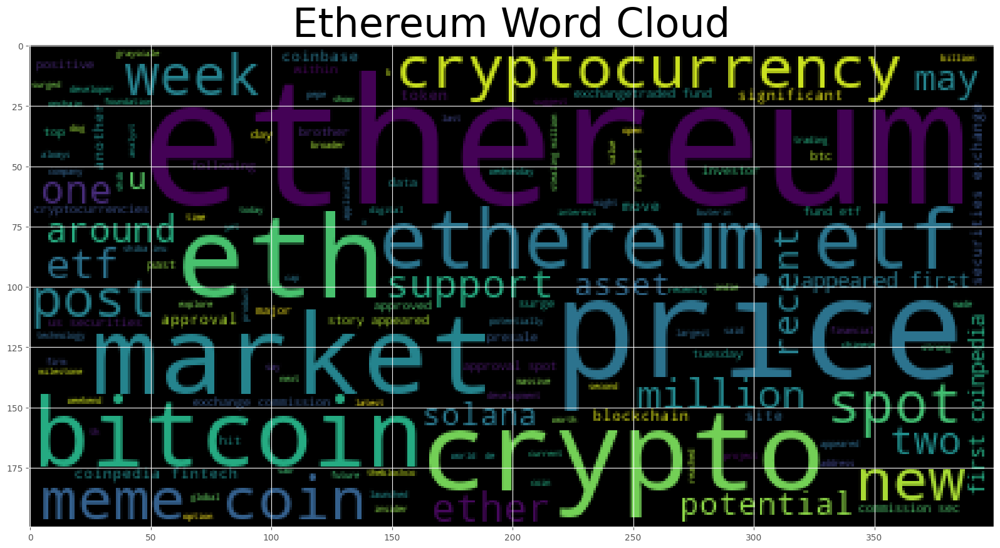

In [34]:
# Generate the Ethereum word cloud
wc = WordCloud().generate(" ".join(eth_processed))
plt.imshow(wc)

# Add title to a Ethereum Word Cloud 
plt.title("Ethereum Word Cloud", fontdict={"fontsize":46})

# Named Entity Recognition

In this section, you will build a named entity recognition model for both coins and visualize the tags using SpaCy.

In [35]:
import spacy
from spacy import displacy

In [36]:
# Load the spaCy model
nlp = spacy.load('en_core_web_sm')

## Bitcoin NER

In [37]:
# Concatenate all of the bitcoin text together
btc_joined = " ".join(btc_processed)

In [38]:
# Run the NER processor on all of the text
doc_btc = nlp(btc_joined)

# Add a title to the document
doc_btc.user_data["title"] = "Bitcoin NER"

In [39]:
# Render the visualization
displacy.render(doc_btc, style='ent')

In [40]:
# List all Entities
print([ent.text for ent in doc_btc.ents])

['january', 'first', 'monthly', 'first', 'one billion', 'week one day', 'el salvador', 'week', 'one', 'april', 'yesterday', 'half billion dollar', 'american', 'million', 'singleday', 'nearly two month', 'wednesday', 'el salvadors', 'federal reserve', 'later wednesday', 'hong kong', 'six', 'tuesday', 'asian', 'marketthe etfs', 'china', 'chi london stock exchange', 'alex blackrocks', 'peter brandt veteran chart', 'state wisconsin', 'million', 'first quarter', 'commissionthe wisconsin investment board', 'jack', 'quarterly', 'week', 'gox', 'approximately million', 'arkham coinbase', 'one', 'thursday', 'chris pancourtesy', 'ohio', 'chris pan', 'los angeles', 'second', 'yahoo', 'week', 'firstquarter', 'late thursday', 'sec', 'nasdaq cboe', 'nyse', 'thursday', 'chinese', 'britishchinese', 'six year', 'announc', 'joe biden begun', 'nicely past two day', 'ten million', 'donald trump', 'saturday', 'evening', 'ross ulbricht', 'nightulbricht donald', 'crypto armyon', 'tuesday', 'tru ross', 'minnes

---

## Ethereum NER

In [41]:
# Concatenate all of the bitcoin text together
eth_joined = " ".join(eth_processed)

In [42]:
# Run the NER processor on all of the text
doc_eth = nlp(eth_joined)

# Add a title to the document
doc_eth.user_data["title"] = "Ethereum NER"

In [43]:
# Render the visualization
displacy.render(doc_eth, style='ent')

In [44]:
# List all Entities
print([ent.text for ent in doc_eth.ents])

['two', 'million', 'million', 'minute', 'claimbygaby de london stock exchange', 'past week', 'sec', 'second', 'yahoo', 'united states', 'us securities exchange commission', 'sec', 'week', 'approximately second', 'two', 'first', 'sec', 'nasdaq cboe', 'nyse', 'thursday', 'hong kong', 'six', 'tuesday', 'asian', 'marketthe etfs', 'china', 'chi', 'two', 'massachusetts institute technology mit', 'wednesday', 'los angeles', 'today', 'donald j', 'last august', 'first', 'two day', 'meme coin', 'al', 'ten million', 'one', 'solana meme', 'coin slothana', 'sloth pepe', 'pepe token', 'chinese', 'chinese yuan', 'south korean', 'wednesday', 'evening', 'meme coin', 'april', 'million', 'meme coin', 'june rd day', 'june', 'utc', 'chinese', 'first', 'one billion', 'week one day', 'two', 'two', 'dutch', 'first', 'netherlands', 'wednesday', 'us securities exchange commission', 'sec', 'gary gensler', 'st century', 'meme coin solana sealana raised', 'million', 'first week', 'launchsealana', 'coin ra', 'milli